# Based on 50 traders price change not thresholded w/ cash/value variable
Use similar clustering and video creation

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from library import utils, config
from library.utils import cosineSimP
import pickle

In [2]:
with open('./results/50_traders_change_price/non_thresholded/' + 'traderIDs_50_pricechange_no_thresholding' + '.pkl', 'rb') as f:
    traderIDs = pickle.load(f)

In [3]:
for i, portf in traderIDs.items():
#     print(len(portf.stocks))
#     print(len(portf.stocks)*len(portf.sharpeReal))
    print((min(portf.weightdata.time)))
    print((max(portf.weightdata.time)))
    print(min(portf.sharpeReal))

992
1998
0.15782881976256402
992
1998
0.11124626987152927
992
1998
0.08055992601698252
992
1998
0.10084431488410159
992
1998
0.06487631929432225
992
1998
0.06637705400997941
992
1998
0.08087636121682264
992
1998
0.05463264343877677
992
1998
0.04480400938300404
992
1998
0.027177801567015197
992
1998
0.05956509536229173
992
1998
0.08163530480599943
992
1998
0.062225999079255766
992
1998
0.05883523839862038
992
1998
0.10828405328005182
992
1998
0.09248647423926154
992
1998
0.07353726544526357
992
1998
0.1090417677257601
992
1998
0.0828892189692911
992
1998
0.04935510597809448
992
1998
0.07137884452372145
992
1998
0.06576965168012262
992
1998
0.07262518544889984
992
1998
0.03994760162542363
992
1998
0.07885599056284734
992
1998
0.0845719120710388
992
1998
0.08438871790728232
992
1998
0.08427571896039002
992
1998
0.03991470156817344
992
1998
0.022404976280334322
992
1998
0.05512337526045949
992
1998
0.06735431799902446
992
1998
0.0817221956293489
992
1998
0.08695553764018063
992
1998
0.1049

In [6]:
mat = np.zeros((50,50))
cosins = {}
for t in range(992,1999):
    mat2 = np.zeros((50,50))
    x = 0
    y = 0
    for i, portf1 in traderIDs.items():
        y=0
        for j, portf2 in traderIDs.items():
            csmp = cosineSimP(t,portf1,portf2)
            mat2[x,y] = csmp
            y += 1
        x += 1
    mat = np.dstack((mat,mat2))
    cosins[str(t)] = np.mean(mat2)
    print(t)
mat = mat[:,:,1:]

992
993
994
995
996
997
998
999
1000
1001
1002
1003
1004
1005
1006
1007
1008
1009
1010
1011
1012
1013
1014
1015
1016
1017
1018
1019
1020
1021
1022
1023
1024
1025
1026
1027
1028
1029
1030
1031
1032
1033
1034
1035
1036
1037
1038
1039
1040
1041
1042
1043
1044
1045
1046
1047
1048
1049
1050
1051
1052
1053
1054
1055
1056
1057
1058
1059
1060
1061
1062
1063
1064
1065
1066
1067
1068
1069
1070
1071
1072
1073
1074
1075
1076
1077
1078
1079
1080
1081
1082
1083
1084
1085
1086
1087
1088
1089
1090
1091
1092
1093
1094
1095
1096
1097
1098
1099
1100
1101
1102
1103
1104
1105
1106
1107
1108
1109
1110
1111
1112
1113
1114
1115
1116
1117
1118
1119
1120
1121
1122
1123
1124
1125
1126
1127
1128
1129
1130
1131
1132
1133
1134
1135
1136
1137
1138
1139
1140
1141
1142
1143
1144
1145
1146
1147
1148
1149
1150
1151
1152
1153
1154
1155
1156
1157
1158
1159
1160
1161
1162
1163
1164
1165
1166
1167
1168
1169
1170
1171
1172
1173
1174
1175
1176
1177
1178
1179
1180
1181
1182
1183
1184
1185
1186
1187
1188
1189
1190
1191
1192
119

In [7]:
print(np.shape(mat))

(50, 50, 1007)


In [8]:
# VID CREATION
# mencoder 'mf://*tmp.png' -mf type=png:fps=4 -ovc lavc -lavcopts vcodec=wmv2 -oac copy -o ./results/no cash variable/100 traders no price change/cosinesim_first_1000_points_100_test_nopricechange.mpg


# Clustering

In [11]:
import hdbscan

clusterer = hdbscan.HDBSCAN()

clusterer.fit(mat[:,:,1])


HDBSCAN()

In [12]:
sortIndices = np.argsort(clusterer.labels_)
print(sortIndices)
# print(np.take_along_axis(clusterer.labels_,sortIndices, axis =0))

[49 25 23 19 13 12  9 44 14  6  7 46  3 15 16 17 18 33 34 35  2 38 32 47
 36 37 39 31 45 30  0 24  1 48  4  5  8 43 42 41 28 10 11 20 21 22 26 27
 29 40]


In [19]:
cosins

{'992': 0.13804328623378728,
 '993': 0.13811109963678728,
 '994': 0.13805885203134965,
 '995': 0.1376872201684953,
 '996': 0.13775467719660592,
 '997': 0.13772723917410598,
 '998': 0.13767308290200608,
 '999': 0.1370189402791278,
 '1000': 0.13752339187632795,
 '1001': 0.13726708721539066,
 '1002': 0.1366026385561547,
 '1003': 0.13658152325706807,
 '1004': 0.13690085534954446,
 '1005': 0.13617701405765115,
 '1006': 0.13671194030631148,
 '1007': 0.13689537728533277,
 '1008': 0.13745333524644823,
 '1009': 0.1376727336114023,
 '1010': 0.13716805821078054,
 '1011': 0.137201912175294,
 '1012': 0.136622951439405,
 '1013': 0.1365881326315898,
 '1014': 0.13578369336151222,
 '1015': 0.13516190176900766,
 '1016': 0.1359699165419033,
 '1017': 0.13570007335478199,
 '1018': 0.13591108958876033,
 '1019': 0.13532088247745114,
 '1020': 0.13531849087815812,
 '1021': 0.13528856615171486,
 '1022': 0.13534430181717633,
 '1023': 0.1358812890750441,
 '1024': 0.13576313657618,
 '1025': 0.13559520720230306,
 '

/home/braedyn/anaconda3/envs/mat36/lib/python3.6/site-packages/ipykernel_launcher.py:2: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  


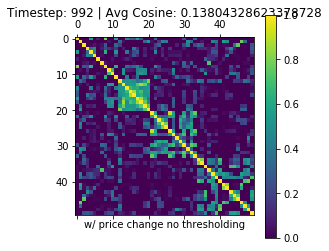

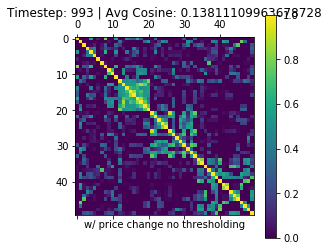

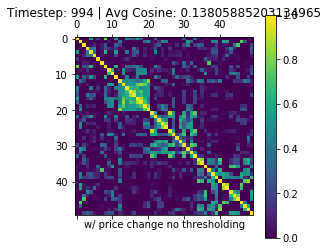

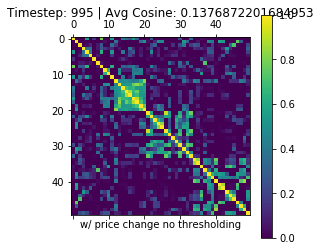

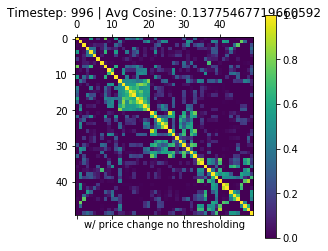

...

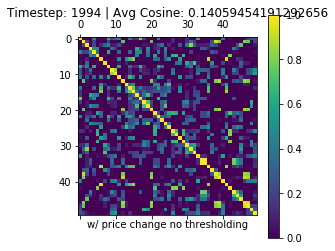

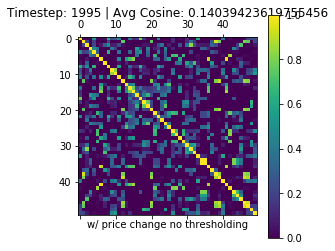

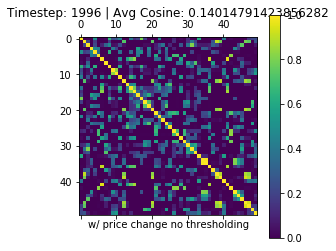

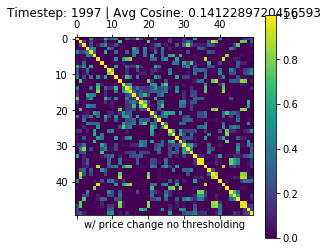

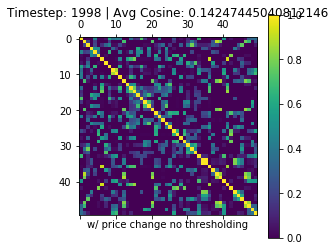

In [15]:
for i,t in enumerate(range(992,1999)):
    plt.matshow(mat[[sortIndices]][:,sortIndices,i]) # from HDBSCAN np.argsort or use np.ix_ 
    plt.title("Timestep: "+ str(t)+" | Avg Cosine: "+str(cosins[str(t)]), y=1.08)
    plt.xlabel("w/ price change no thresholding")
    plt.colorbar()
    plt.savefig('./results/50_traders_change_price/non_thresholded/'+str(t).zfill(6)+'tmp.png', dpi=300)
    plt.show()

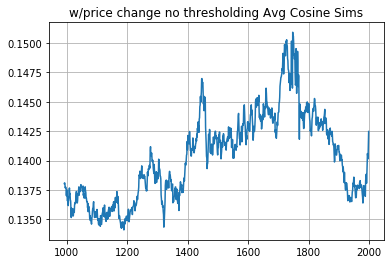

In [22]:
# mencoder 'mf://*tmp.png' -mf type=png:fps=4 -ovc lavc -lavcopts vcodec=wmv2 -oac copy -o ./cosinesim_5950_points_50_pricechange_nothresholding.mpg
plt.plot(range(992,1999), list(cosins.values()))
plt.title("w/price change no thresholding Avg Cosine Sims")
plt.grid(True)
plt.savefig("./results/50_traders_change_price/non_thresholded/avgcosines_pc_nothresh.png")
plt.show()
